In [6]:
import random
import time
import os
from IPython.display import clear_output
import gc
import re


import numpy as np
import cv2
import torch
from torch import nn, optim, cuda
# from torch.optim.lr_scheduler import CosineAnnealingLR
from torchvision import transforms
from torch.utils.data import Dataset, DataLoader
# from torchmetrics import JaccardIndex, Dice
import matplotlib.pyplot as plt
import segmentation_models_pytorch as smp
from PIL import Image


BS = 120
DATASET_SHOW_SIZE = 50
RESIZE = (224, 224)

Check for CUDA available

In [7]:
device = 'cpu'
if cuda.is_available():
    device_name = cuda.get_device_name(0)
    memory = cuda.get_device_properties(0).total_memory / (1024 ** 3)
    print(f"Device {device_name} has {memory} GB of memory")
    device = torch.device('cuda')
    torch.cuda.empty_cache()
    gc.collect()
else:
    raise Exception("Cuda isn't available")
device

Device NVIDIA GeForce RTX 3060 Ti has 7.9993896484375 GB of memory


device(type='cuda')

Transform ad augment dataset

In [8]:
val_transform = transforms.Compose([
    transforms.Resize(RESIZE),
    transforms.ToTensor(),
    transforms.ConvertImageDtype(dtype=torch.float32),
])

train_transform = transforms.Compose([
    # transforms.RandomHorizontalFlip(p=0.5),
    # transforms.RandomVerticalFlip(p=0.5),
    # transforms.RandomRotation(degrees=180),

    transforms.Resize(RESIZE),
    transforms.ToTensor(),
    transforms.ConvertImageDtype(dtype=torch.float32)
])

color_transform = transforms.Compose([
    # transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.05),
])

normalize_transform = transforms.Compose([
    # transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])


class SegmentationDataset(Dataset):
    def __init__(self, root, uniform_transform, color_transform=None, normalize_transform=None):
        self.image_dir = os.path.join(root, 'images')
        self.mask_dir = os.path.join(root, 'labels')
        self.images = os.listdir(self.image_dir)

        self.uniform_transform = uniform_transform
        self.color_transform = color_transform
        self.normalize_transform = normalize_transform

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        img_path = os.path.join(self.image_dir, self.images[idx])
        mask_path = os.path.join(self.mask_dir, self.images[idx])

        image = Image.open(img_path).convert("RGB")
        mask = Image.open(mask_path).convert("L")

        seed = np.random.randint(2147483647)

        random.seed(seed)
        torch.manual_seed(seed)
        np.random.seed(seed)
        image = self.uniform_transform(image)

        random.seed(seed)
        torch.manual_seed(seed)
        np.random.seed(seed)
        mask = self.uniform_transform(mask)

        if self.color_transform:
            image = self.color_transform(image)

        if self.normalize_transform:
            image = self.normalize_transform(image)

        mask = (mask > 0).float()  # Ensure mask is binary (0 or 1)

        return image, mask

train_dataset = SegmentationDataset('./dataset-183/train', train_transform, color_transform=color_transform)
val_dataset = SegmentationDataset('./dataset-183/val', val_transform)

train_loader = DataLoader(train_dataset, batch_size=BS, shuffle=True)
val_loader = DataLoader(val_dataset, batch_size=BS, shuffle=False)

original_train_dataset = SegmentationDataset('./dataset-183/train', val_transform)
original_train_loader = DataLoader(original_train_dataset, batch_size=BS, shuffle=False)

augmented_train_dataset = SegmentationDataset('./dataset-183/train', train_transform, color_transform)
augmented_train_loader = DataLoader(augmented_train_dataset, batch_size=BS, shuffle=False)

Check dataset stat

In [9]:
train_count = len(train_dataset)
val_count = len(val_dataset)

print("Train Dataset Image Count:")
print(train_count)

print("Val Dataset Image Count:")
print(val_count)

Train Dataset Image Count:
183
Val Dataset Image Count:
52


Compare original and augmented images

In [10]:
def show_original_and_augmented(original_images, augmented_images, original_masks, augmented_masks):
    fig, axes = plt.subplots(DATASET_SHOW_SIZE, 4, figsize=(DATASET_SHOW_SIZE, DATASET_SHOW_SIZE * 4))
    for i in range(0, DATASET_SHOW_SIZE, 1):
        axes[i, 0].imshow(original_images[i].permute(1, 2, 0))
        axes[i, 0].axis('off')

        axes[i, 1].imshow(augmented_images[i].permute(1, 2, 0))
        axes[i, 1].axis('off')

        axes[i, 2].imshow(original_masks[i].squeeze(), cmap='gray')
        axes[i, 2].axis('off')

        axes[i, 3].imshow(augmented_masks[i].squeeze(), cmap='gray')
        axes[i, 3].axis('off')
    plt.show()

original_images, original_masks = next(iter(original_train_loader))
augmented_images, augmented_masks = next(iter(augmented_train_loader))

show_original_and_augmented(original_images, augmented_images, original_masks, augmented_masks)

Delete model to avoid errors with pretrained

In [11]:
try:
  if model:
    model.zero_grad()
    del model
    torch.cuda.empty_cache()
    print('model has been deleted')
except:
  print('model doesnt exist')

model doesnt exist


Init model

In [12]:
model = smp.Unet(
    encoder_name="resnet34",
    encoder_weights="imagenet",
    in_channels=3,
    classes=1,
)

model.to(device)
# model

Unet(
  (encoder): ResNetEncoder(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track

In [13]:
class FocalLoss(nn.Module):
    def __init__(self, alpha=1, gamma=2, logits=False, reduce=True):
        super(FocalLoss, self).__init__()
        self.alpha = alpha
        self.gamma = gamma
        self.logits = logits
        self.reduce = reduce

    def forward(self, inputs, targets):
        if self.logits:
            BCE_loss = nn.functional.binary_cross_entropy_with_logits(inputs, targets, reduction='none')
        else:
            BCE_loss = nn.functional.binary_cross_entropy(inputs, targets, reduction='none')
        pt = torch.exp(-BCE_loss)
        F_loss = self.alpha * (1 - pt) ** self.gamma * BCE_loss

        if self.reduce:
            return torch.mean(F_loss)
        else:
            return F_loss


class JaccardLoss(nn.Module):
    def __init__(self, smooth=1e-10):
        super(JaccardLoss, self).__init__()
        self.smooth = smooth

    def forward(self, inputs, targets):
        inputs = torch.sigmoid(inputs)
        intersection = (inputs * targets).sum()
        union = inputs.sum() + targets.sum() - intersection
        jaccard = (intersection + self.smooth) / (union + self.smooth)
        return 1 - jaccard


class CombinedLoss(nn.Module):
    def __init__(self, smooth=1e-10):
        super(CombinedLoss, self).__init__()
        self.bcel_loss = nn.BCEWithLogitsLoss()
        self.jaccard_loss = JaccardLoss(smooth=smooth)

    def forward(self, inputs, targets):
        bcel_loss = self.bcel_loss(inputs, targets)
        jaccard_loss = self.jaccard_loss(inputs, targets)
        return bcel_loss + jaccard_loss

Define hyperparameters

In [14]:
criterion = nn.BCEWithLogitsLoss()
# criterion = CombinedLoss()
optimizer = optim.Adam(model.parameters(), lr=0.0005, weight_decay=1e-6)
num_epochs = 50

len_loader = len(train_loader)

Make and manage runs dir

In [15]:
def get_run_index(run_name):
    match = re.match(r'run(\d+)', run_name)
    return int(match.group(1)) if match else -1

runs_dir = "runs"
os.makedirs(runs_dir, exist_ok=True)
existing_runs = [d for d in os.listdir(runs_dir) if os.path.isdir(os.path.join(runs_dir, d))]

if existing_runs:
    max_index = max([get_run_index(d) for d in existing_runs])
    new_run_index = max_index + 1
else:
    new_run_index = 1

current_run_dir = os.path.join(runs_dir, f"run{new_run_index}")
os.makedirs(current_run_dir, exist_ok=True)

train_stats_file = os.path.join(current_run_dir, "train_stats.csv")
test_stats_file = os.path.join(current_run_dir, "test_stats.txt")
best_model_weights_file = os.path.join(current_run_dir, "best.pth")
plot_file = os.path.join(current_run_dir, "plot.png")

with open(train_stats_file, 'w') as f:
    f.write(f"Epoch,Epochs,Train Loss,Val Loss,Val IoU,Val DICE,Dur,Dur/Epoch\n")

def update_run_dir(current_dir, new_run_index, iou, dice, epochs):
    new_dir_name = f"run{new_run_index}_iou_{iou:.4f}_dice_{dice:.4f}_epochs_{epochs}"
    new_dir_path = os.path.join(runs_dir, new_dir_name)
    os.rename(current_dir, new_dir_path)
    return new_dir_path

Show loss plot, metrics plot and last epoch stats

In [16]:
def show_stats(x_vals, train_losses, val_losses, IoU_list, DICE_list):
    clear_output(wait=True)

    if not x_vals:
        return

    #fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 8))
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(16, 8))

    ax1.plot(x_vals, train_losses, label='Train Loss')
    ax1.plot(x_vals, val_losses, label='Val Loss')
    ax1.legend()
    ax1.grid(True)
    ax1.set_xticks(x_vals[::5])
    ax1.set_xticklabels(x_vals[::5], rotation=90)
    ax1.set_title('Loss')

    # Второй график
    ax2.plot(x_vals, IoU_list, label='IoU')
    ax2.plot(x_vals, DICE_list, label='DICE')
    ax2.legend()
    ax2.grid(True)
    ax2.set_xticks(x_vals[::5])
    ax2.set_xticklabels(x_vals[::5], rotation=90)
    ax2.set_title('Metrics')

    plt.savefig(plot_file)
    plt.tight_layout()
    plt.show()

    print(f"Train Loss: {train_losses[-1]}")
    print(f"Val Loss {val_losses[-1]}")
    print(f"IoU: {IoU_list[-1]}")
    print(f"DICE: {DICE_list[-1]}")

In [17]:
def calculate_metrics(predicted, labels):
    div_epsilon = 1e-10

    predicted = predicted.view(-1)
    labels = labels.view(-1)

    TP = (predicted * labels).sum().item()
    FP = ((1 - labels) * predicted).sum().item()
    FN = (labels * (1 - predicted)).sum().item()
    TN = ((1 - labels) * (1 - predicted)).sum().item()

    iou = TP / (TP + FP + FN + div_epsilon)
    dice = (2 * TP) / (2 * TP + FP + FN + div_epsilon)

    return iou, dice

Train loop

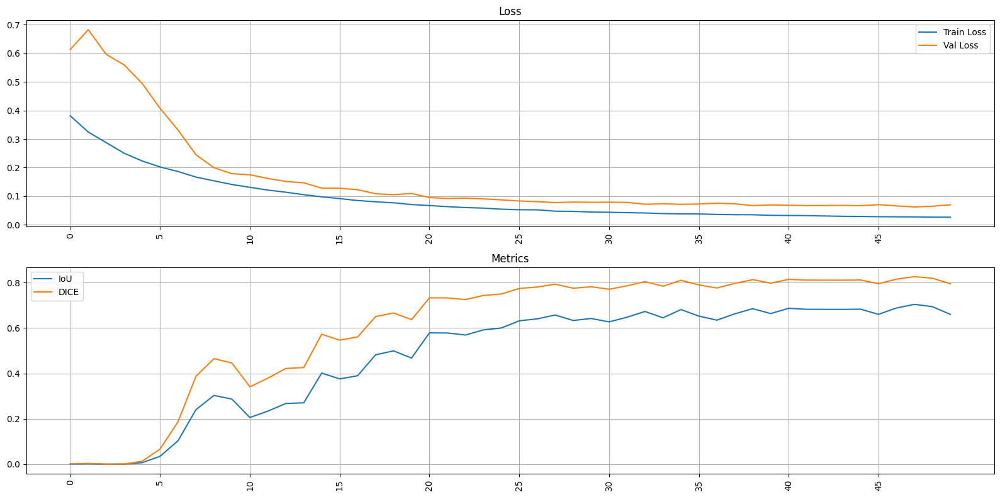

Train Loss: 0.02665182203054428
Val Loss 0.07013974338769913
IoU: 0.6600273132520803
DICE: 0.7952005463802307


In [18]:
x_vals = []
train_losses = []
val_losses = []

IoU_list = []
DICE_list = []

best_val_loss = float('inf')
best_val_IoU = 0.0
best_val_DICE = 0.0
best_epoch = 0

div_epsilon = 1e-10

start = time.time()
for epoch in range(num_epochs):
    print(f'\rEpoch: {epoch} / {num_epochs}')
    epoch_start = time.time()
    model.train()
    running_loss = 0.0
    val_running_loss = 0.0

    for batch_idx, (images, labels) in enumerate(train_loader):
        print(f"\r Train batch {batch_idx}/{len(train_loader)}", end='', flush=True)

        images = images.to(device)
        labels = labels.to(device)

        optimizer.zero_grad()
        outputs = model(images)

        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    epoch_train_loss = running_loss / len(train_loader)
    x_vals.append(epoch)
    train_losses.append(epoch_train_loss)
    print('\n')

    model.eval()

    val_IoU = 0.0
    val_DICE = 0.0
    num_batches = 0

    with torch.no_grad():
        for batch_idx, (images, labels) in enumerate(val_loader):
            print(f"\r Val batch {batch_idx}/{len(val_loader)}", end='', flush=True)

            images = images.to(device)
            labels = labels.to(device)

            outputs = model(images)
            loss = criterion(outputs, labels)
            val_running_loss += loss.item()

            predicted = (outputs > 0.5).float()

            iou, dice = calculate_metrics(predicted, labels)
            val_IoU += iou
            val_DICE += dice
            num_batches += 1

        epoch_val_loss = val_running_loss / len(val_loader)
        avg_val_IoU = val_IoU / num_batches
        avg_val_DICE = val_DICE / num_batches

    val_losses.append(epoch_val_loss)
    IoU_list.append(avg_val_IoU)
    DICE_list.append(avg_val_DICE)

    if epoch_val_loss < best_val_loss:
        best_val_loss = epoch_val_loss
        best_val_IoU = avg_val_IoU
        best_val_DICE = avg_val_DICE
        best_epoch = epoch
        torch.save(model.state_dict(), best_model_weights_file)
        dur = time.time() - start

        current_run_dir = update_run_dir(current_run_dir, new_run_index, best_val_IoU, best_val_DICE, epoch)
        # Обновление путей файлов после изменения имени директории
        train_stats_file = os.path.join(current_run_dir, "train_stats.csv")
        test_stats_file = os.path.join(current_run_dir, "test_stats.txt")
        best_model_weights_file = os.path.join(current_run_dir, "best.pth")
        plot_file = os.path.join(current_run_dir, "plot.png")
        predict_file = os.path.join(current_run_dir, "test-results.png")

        with open(train_stats_file, "a") as f:
            f.write(f"{epoch + 1},{num_epochs},{round(epoch_train_loss, 8)},{round(epoch_val_loss, 8)},{round(avg_val_IoU, 8)},{round(avg_val_DICE, 8)},{round(dur, 6)},{round(dur / epoch if epoch != 0 else 0, 4)}\n")
    elif epoch > best_epoch + (num_epochs // 2):
        print(f"\nTraining has stopped at {epoch} / {num_epochs} cuz val loss didn't decrease for {num_epochs // 2} epochs")
        break

    show_stats(x_vals, train_losses, val_losses, IoU_list, DICE_list)


#31 runs:


In [19]:
def show_images_grid(originals, predicted_masks, true_masks):
    num_images = len(originals)
    fig, axes = plt.subplots(num_images, 5, figsize=(25, 5 * num_images))

    for i in range(num_images):
        original_img = originals[i].transpose(1, 2, 0)

        axes[i, 0].imshow(original_img)
        axes[i, 0].set_title(f'Image {i}')
        axes[i, 0].axis('off')

        axes[i, 1].imshow(predicted_masks[i].squeeze(), cmap='gray')
        axes[i, 1].set_title('Predicted Mask')
        axes[i, 1].axis('off')

        axes[i, 2].imshow(true_masks[i].squeeze(), cmap='gray')
        axes[i, 2].set_title('True Mask')
        axes[i, 2].axis('off')

        overlay_red = original_img.copy()
        overlay_red[predicted_masks[i].squeeze() > 0.5] = [255, 0, 0]
        blended_red = cv2.addWeighted(original_img, 0.5, overlay_red, 0.5, 0)

        axes[i, 3].imshow(blended_red)
        axes[i, 3].set_title('Image + predicted mask')
        axes[i, 3].axis('off')

        overlay_green = original_img.copy()
        overlay_green[true_masks[i].squeeze() > 0.5] = [0, 255, 0]
        combined_overlay = cv2.addWeighted(blended_red, 0.5, overlay_green, 0.5, 0)

        axes[i, 4].imshow(combined_overlay)
        axes[i, 4].set_title('Red predicted and Green True')
        axes[i, 4].axis('off')

    plt.tight_layout()
    plt.savefig(predict_file)
    plt.show()

def calculate_metrics(predicted, labels):
    predicted = predicted.view(-1)
    labels = labels.view(-1)

    TP = (predicted * labels).sum().item()
    FP = ((1 - labels) * predicted).sum().item()
    FN = (labels * (1 - predicted)).sum().item()
    TN = ((1 - labels) * (1 - predicted)).sum().item()

    iou = TP / (TP + FP + FN + 1e-10)
    dice = (2 * TP) / (2 * TP + FP + FN + 1e-10)

    return iou, dice

def test(model, test_loader, criterion, device):
    model.eval()
    test_running_loss = 0.0
    true_labels = []
    predicted_labels = []

    originals = []
    predicted_masks = []
    true_masks = []

    with torch.no_grad():
        for batch_idx, (images, labels) in enumerate(test_loader):
            print(f"\r Test batch {batch_idx}/{len(test_loader)}", end='', flush=True)
            images = images.to(device)
            labels = labels.to(device)

            outputs = model(images)
            loss = criterion(outputs, labels)
            test_running_loss += loss.item()
            predicted = (outputs > 0.5).float()

            true_labels.extend(labels.cpu().numpy().flatten())
            predicted_labels.extend(predicted.cpu().numpy().flatten())

            for i in range(len(images)):
                original = images[i].cpu().numpy()
                predicted_mask = predicted[i].cpu().numpy()
                true_mask = labels[i].cpu().numpy()
                originals.append(original)
                predicted_masks.append(predicted_mask)
                true_masks.append(true_mask)

            iou, dice = calculate_metrics(predicted, labels)
            print(f"Batch {batch_idx} - IoU: {iou:.4f}, Dice: {dice:.4f}")

        avg_iou, avg_dice = calculate_metrics(torch.tensor(predicted_labels), torch.tensor(true_labels))
        test_loss = test_running_loss / len(test_loader)

    print(f"Overall - IoU: {avg_iou:.4f}, Dice: {avg_dice:.4f}")

    # Показать все изображения в одной фигуре
    show_images_grid(originals, predicted_masks, true_masks)

    return test_loss, avg_iou, avg_dice

test_loss, avg_iou, avg_dice = test(model, val_loader, criterion, device)
print(f"Test Loss: {test_loss}, Avg IoU: {avg_iou}, Avg Dice: {avg_dice}")

 Test batch 0/1Batch 0 - IoU: 0.6600, Dice: 0.7952
Overall - IoU: 0.6600, Dice: 0.7952


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..127.99608].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..127.92157].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0627451..128.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0627451..127.95686].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.011764706..128.0].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.011764706..127.97255].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.011764706..127.95294].
Clippi

Test Loss: 0.07013974338769913, Avg IoU: 0.6600273132520803, Avg Dice: 0.7952005463802307


In [20]:
#10 epochs: Test Loss: 0.2050, Test Accuracy: 0.9193, Test Precision: 0.5031, Test Recall: 0.4503, Test F1-score: 0.4696
#50 epochs: Test Loss: 0.2354, Test Accuracy: 0.9022, Test Precision: 0.5031, Test Recall: 0.4379, Test F1-score: 0.4616